### ***Task : Apply knowledge distillation techniques by training a model on a European dataset (teacher model) and then using this model to guide the training of a smaller model (student model) for predicting GSNR (General Signal-to-Noise Ratio) on the same European dataset. Do the same for USA dataset as well.***

### **European Dataset**

**Step 1: Understanding Distillation Techniques**

Knowledge distillation is a process where a smaller model (student model) is trained to replicate the performance of a larger, pre-trained model (teacher model). The key concepts include:

***Hard Distillation:*** The student model is trained using the same ground truth labels as the teacher model.

***Soft Distillation:*** The student model is trained using the soft labels (probability distributions) provided by the teacher model, often with a temperature parameter to smooth the outputs.

**Step 2: Data Preparation**

In [1]:
pip install memory-profiler


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from sklearn.utils import resample
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
import time
from memory_profiler import memory_usage
import psutil
import os

In [3]:
# Load European dataset
european_data = pd.read_excel('/content/DataSet_EU_3k_5k.xlsx')

In [4]:
# Drop columns frequency_1 to frequency_76 and GSNR_2 to GSNR_76
columns_to_drop = [f'frequency_{i}' for i in range(1, 77)] + [f'GSNR_{i}' for i in range(2, 77)]

european_data = european_data.drop(columns=columns_to_drop)

In [5]:
# Basic exploration
print(european_data.head())
print(european_data.info())
print(european_data.describe())

    Power_1   Power_2   Power_3   Power_4   Power_5   Power_6   Power_7  \
0  0.000000  0.000000  0.000007  0.000007  0.000007  0.000000  0.000007   
1  0.000000  0.000007  0.000000  0.000007  0.000000  0.000007  0.000000   
2  0.000000  0.000000  0.000000  0.000007  0.000000  0.000000  0.000000   
3  0.000007  0.000007  0.000007  0.000007  0.000007  0.000000  0.000000   
4  0.000000  0.000000  0.000007  0.000000  0.000007  0.000000  0.000000   

   Power_8   Power_9  Power_10  ...        ASE_70        ASE_71        ASE_72  \
0      0.0  0.000007       0.0  ...  7.544798e-06  7.544798e-06  7.544798e-06   
1      0.0  0.000000       0.0  ...  4.300201e-08  7.353422e-06  7.353422e-06   
2      0.0  0.000007       0.0  ...  7.411925e-06  4.770912e-08  7.411925e-06   
3      0.0  0.000007       0.0  ...  4.777708e-08  4.761294e-08  4.990965e-08   
4      0.0  0.000007       0.0  ...  7.187909e-06  4.648247e-08  4.506342e-08   

         ASE_73        ASE_74        ASE_75        ASE_76     

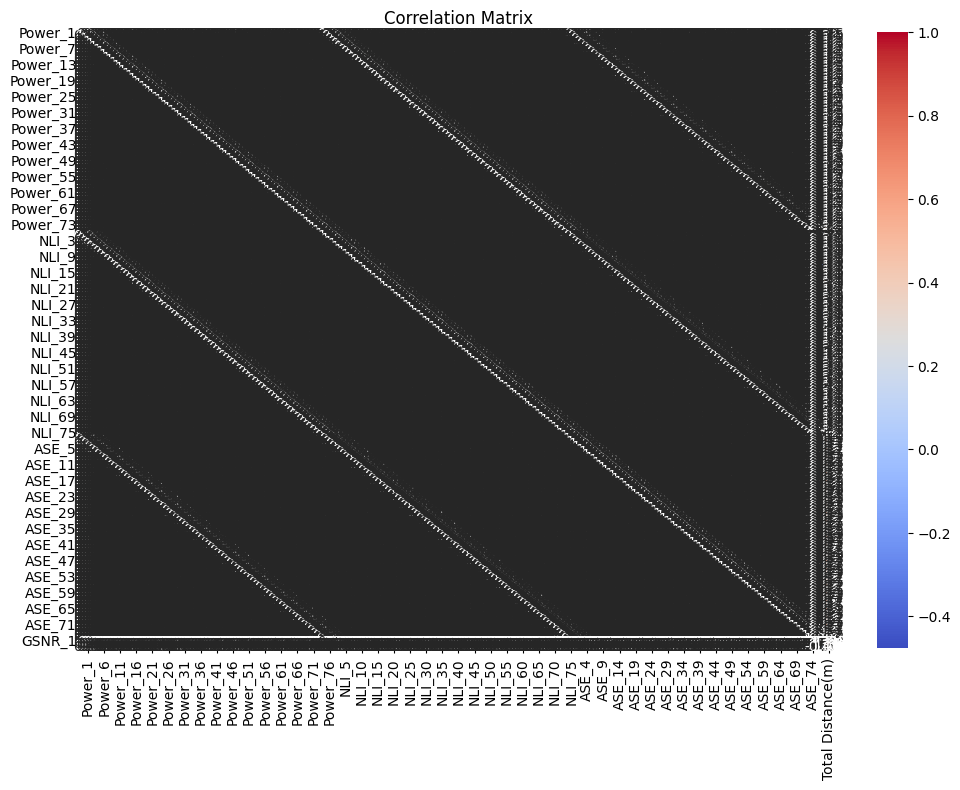

In [6]:
# Select relevant columns
features = european_data.columns.difference(['GSNR_1'])
target = 'GSNR_1'

# Combine the datasets for visualization
european_data['Dataset'] = 'European'
combined_data = pd.concat([european_data])

# Correlation matrix (excluding 'Dataset' column)
plt.figure(figsize=(12, 8))
correlation_matrix = combined_data.drop(columns=['Dataset']).corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [7]:
# Number of columns for the subplots
num_cols = 5

# Individual feature distributions
num_features = len(features)
num_rows = (num_features + num_cols - 1) // num_cols  # Calculate the number of rows needed

plt.figure(figsize=(num_cols * 6, num_rows * 4))

for i, feature in enumerate(features):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.histplot(combined_data[feature], kde=True, bins=30)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

# Relationship with target variable
plt.figure(figsize=(num_cols * 6, num_rows * 4))

for i, feature in enumerate(features):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.scatterplot(x=combined_data[feature], y=combined_data[target], hue=combined_data['Dataset'])
    plt.title(f'Relationship between {feature} and {target}')
    plt.xlabel(feature)
    plt.ylabel(target)

plt.tight_layout()
plt.show()

In [8]:
#Select relevant columns for features and target
features = european_data.columns.difference(['GSNR_1', 'Dataset'])
target = 'GSNR_1'

# Separate features and target
X_european = european_data[features]
y_european = european_data[[target]]  # Ensure y is a DataFrame for consistent scaling

In [9]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Assume european_data and usa_data are your DataFrames

# Select relevant columns for features and target
features = european_data.columns.difference(['GSNR_1', 'Dataset'])
target = 'GSNR_1'

# Separate features and target
X_european = european_data[features]
y_european = european_data[[target]]  # Ensure y is a DataFrame for consistent scaling

# Initialize the scaler
scaler = MinMaxScaler()

# Fit and transform the features and target
X_european_scaled = scaler.fit_transform(X_european)
y_european_scaled = scaler.fit_transform(y_european)

# Flatten the target variables
y_european_flat = y_european_scaled.flatten()

# Convert the scaled features back to DataFrames for easier handling
X_european_scaled = pd.DataFrame(X_european_scaled, columns=features)

# Convert the flattened target variables back to Series for consistency
y_european_flat = pd.Series(y_european_flat, name=target)

**Step 3: Model Training on European Dataset**

In [11]:
# Define the function to split data according to the specified pattern
def custom_train_test_split(data, labels, samples_per_block=3000, train_samples_per_block=2500, test_samples_per_block=500):
    # Initialize lists to hold the training and testing data and labels
    train_data = []
    test_data = []
    train_labels = []
    test_labels = []

    # Determine the total number of samples in the data
    total_samples = len(data)

    # Loop over the data in blocks of the specified size (samples_per_block)
    for start in range(0, total_samples, samples_per_block):
        # Define the end of the current block
        end = start + samples_per_block
        # Define the end of the training samples within the current block
        train_end = start + train_samples_per_block

        # Adjust train_end and end if they exceed the total number of samples
        if train_end > total_samples:
            train_end = total_samples
        if end > total_samples:
            end = total_samples

        # Append the training and testing data and labels for the current block to the respective lists
        train_data.append(data[start:train_end])
        test_data.append(data[train_end:end])
        train_labels.append(labels[start:train_end])
        test_labels.append(labels[train_end:end])

    # Concatenate the lists into DataFrames and reset the index
    train_data = pd.concat(train_data).reset_index(drop=True)
    test_data = pd.concat(test_data).reset_index(drop=True)
    train_labels = pd.concat(train_labels).reset_index(drop=True)
    test_labels = pd.concat(test_labels).reset_index(drop=True)

    # Return the training and testing data and labels
    return train_data, test_data, train_labels, test_labels

# Create a list of attribute columns excluding those that start with 'frequency'
attribute_columns_without_frequency = [col for col in features if not col.startswith('frequency')]

# Assuming 'x' and 'y' are your DataFrames for MinMax normalized data
# Perform the custom train-test split on the normalized data
X_train, X_test, Y_train, Y_test = custom_train_test_split(X_european_scaled, y_european_flat)

# Display shapes to verify the split
print("Normalized data with equal path distribution in train and test data :\n")
print("Train data shape:", X_train.shape)
print("Test data shape:", X_test.shape)
print("Train labels shape:", Y_train.shape)
print("Test labels shape:", Y_test.shape)

Normalized data with equal path distribution in train and test data :

Train data shape: (15000, 230)
Test data shape: (3000, 230)
Train labels shape: (15000,)
Test labels shape: (3000,)


In [12]:
# Define a large teacher model architecture
teacher_model = Sequential([
    Dense(256, activation='relu', input_shape=(len(features),)),  # First layer with 256 neurons
    Dropout(0.2),  # Add dropout for regularization
    Dense(128, activation='relu'),  # Second layer with 128 neurons
    Dropout(0.2),
    Dense(64, activation='relu'),  # Third layer with 64 neurons
    Dropout(0.2),
    Dense(32, activation='relu'),  # Fourth layer with 32 neurons
    Dense(16, activation='relu'),  # Fifth layer with 16 neurons
    Dense(1)  # Output layer for regression task
])

# Compile the model
teacher_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the teacher model
history = teacher_model.fit(X_train, Y_train, epochs=25, batch_size=64, validation_split=0.2)  # Increase epochs for better training

# Evaluate the teacher model
val_loss, val_mae = teacher_model.evaluate(X_test, Y_test)
print(f"Validation MAE: {val_mae}")


Epoch 1/25
188/188 [==============================] - 5s 8ms/step - loss: 0.0387 - mae: 0.1264 - val_loss: 0.0049 - val_mae: 0.0475
Epoch 2/25
188/188 [==============================] - 1s 8ms/step - loss: 0.0028 - mae: 0.0346 - val_loss: 8.8178e-04 - val_mae: 0.0194
Epoch 3/25
188/188 [==============================] - 1s 7ms/step - loss: 0.0012 - mae: 0.0210 - val_loss: 9.3956e-04 - val_mae: 0.0172
Epoch 4/25
188/188 [==============================] - 1s 7ms/step - loss: 7.9541e-04 - mae: 0.0158 - val_loss: 9.7856e-04 - val_mae: 0.0165
Epoch 5/25
188/188 [==============================] - 1s 7ms/step - loss: 6.1250e-04 - mae: 0.0136 - val_loss: 0.0013 - val_mae: 0.0197
Epoch 6/25
188/188 [==============================] - 1s 6ms/step - loss: 6.0560e-04 - mae: 0.0128 - val_loss: 0.0019 - val_mae: 0.0248
Epoch 7/25
188/188 [==============================] - 1s 7ms/step - loss: 3.5229e-04 - mae: 0.0102 - val_loss: 0.0027 - val_mae: 0.0309
Epoch 8/25
188/188 [============================

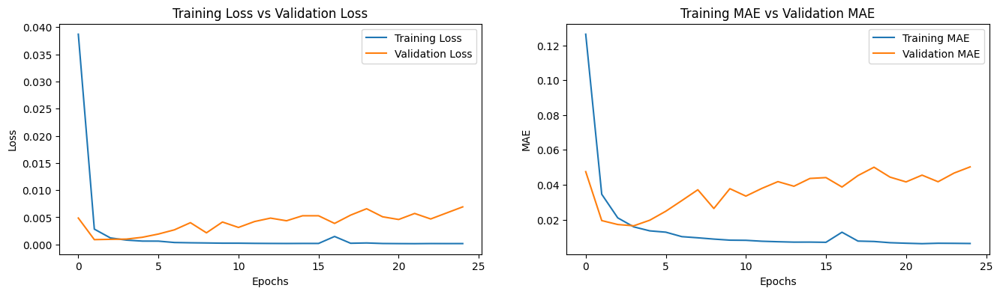

In [13]:
# Plot the training loss vs validation loss
plt.figure(figsize=(16, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training Loss vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot MAE
plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.title('Training MAE vs Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()


**Step 4 : Training Student Model**

**Hard Distillation**

In [14]:
# Define the student model architecture
student_model_hard = Sequential([
    Dense(64, activation='relu', input_shape=(len(features),)),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dropout(0.2),
    Dense(1)
])

# Compile the student model
student_model_hard.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the student model
history_hard = student_model_hard.fit(X_train, Y_train, epochs=25, batch_size=64, validation_split=0.2)  # Increase epochs for better training

# Evaluate the student model
val_loss_hard, val_mae_hard = student_model_hard.evaluate(X_test, Y_test)
print(f"Validation MAE (Hard Distillation): {val_mae_hard}")


Epoch 1/25
188/188 [==============================] - 2s 5ms/step - loss: 0.0710 - mae: 0.1848 - val_loss: 0.0998 - val_mae: 0.2845
Epoch 2/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0376 - mae: 0.1334 - val_loss: 0.0406 - val_mae: 0.1773
Epoch 3/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0154 - mae: 0.0800 - val_loss: 0.0038 - val_mae: 0.0384
Epoch 4/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0059 - mae: 0.0478 - val_loss: 0.0021 - val_mae: 0.0282
Epoch 5/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0044 - mae: 0.0397 - val_loss: 0.0023 - val_mae: 0.0292
Epoch 6/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0035 - mae: 0.0353 - val_loss: 8.7711e-04 - val_mae: 0.0195
Epoch 7/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0035 - mae: 0.0339 - val_loss: 0.0025 - val_mae: 0.0311
Epoch 8/25
188/188 [==============================] - 1s 7ms/step - loss

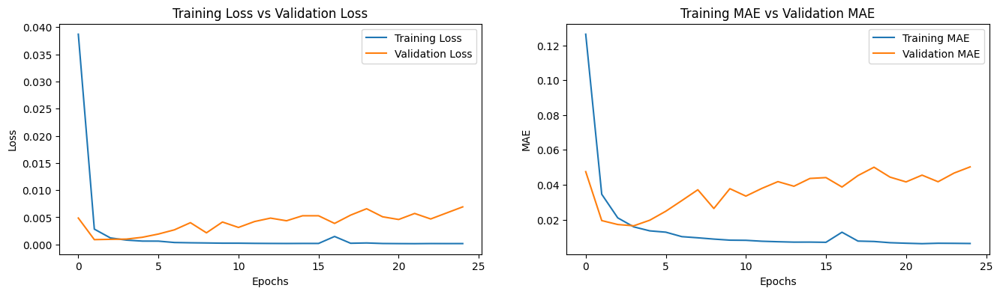

In [15]:
# Plot the training loss vs validation loss
plt.figure(figsize=(16, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training Loss vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot MAE
plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.title('Training MAE vs Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()


**Soft Distillation**

In [16]:
def get_softened_outputs(model, data, temperature=1):
    logits = model.predict(data) / temperature
    exp_logits = np.exp(logits)
    return exp_logits / np.sum(exp_logits, axis=1, keepdims=True)

In [17]:
# Define the student model architecture
def create_student_model(input_shape):
    model = Sequential([
        Dense(64, activation='relu', input_shape=input_shape),
        Dropout(0.2),
        Dense(32, activation='relu'),
        Dropout(0.2),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse', metrics=['mae'])
    return model


### Training with Temperature 1 ###
469/469 [==============================] - 2s 4ms/step
Epoch 1/25
188/188 [==============================] - 3s 8ms/step - loss: 0.1090 - mae: 0.2406 - val_loss: 0.0268 - val_mae: 0.1495
Epoch 2/25
188/188 [==============================] - 1s 5ms/step - loss: 0.0214 - mae: 0.1142 - val_loss: 0.0219 - val_mae: 0.1371
Epoch 3/25
188/188 [==============================] - 1s 5ms/step - loss: 0.0159 - mae: 0.0970 - val_loss: 0.0184 - val_mae: 0.1204
Epoch 4/25
188/188 [==============================] - 1s 5ms/step - loss: 0.0125 - mae: 0.0845 - val_loss: 0.0139 - val_mae: 0.1012
Epoch 5/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0097 - mae: 0.0736 - val_loss: 0.0049 - val_mae: 0.0620
Epoch 6/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0069 - mae: 0.0616 - val_loss: 0.0027 - val_mae: 0.0396
Epoch 7/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0057 - mae: 0.0551 - val_loss: 8.2137e-0

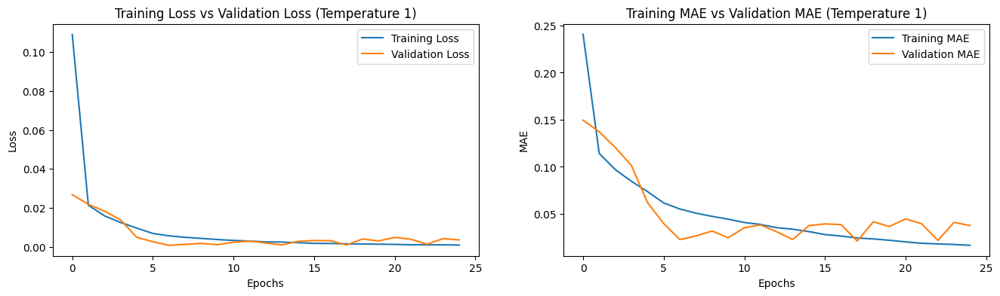


### Training with Temperature 5 ###
469/469 [==============================] - 1s 2ms/step
Epoch 1/25
188/188 [==============================] - 2s 6ms/step - loss: 0.0619 - mae: 0.1822 - val_loss: 0.0232 - val_mae: 0.1372
Epoch 2/25
188/188 [==============================] - 1s 6ms/step - loss: 0.0145 - mae: 0.0910 - val_loss: 0.0166 - val_mae: 0.1134
Epoch 3/25
188/188 [==============================] - 1s 6ms/step - loss: 0.0105 - mae: 0.0771 - val_loss: 0.0104 - val_mae: 0.0816
Epoch 4/25
188/188 [==============================] - 1s 5ms/step - loss: 0.0072 - mae: 0.0651 - val_loss: 0.0030 - val_mae: 0.0457
Epoch 5/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0055 - mae: 0.0569 - val_loss: 0.0025 - val_mae: 0.0392
Epoch 6/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0047 - mae: 0.0516 - val_loss: 0.0017 - val_mae: 0.0323
Epoch 7/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0040 - mae: 0.0472 - val_loss: 0.0013 - 

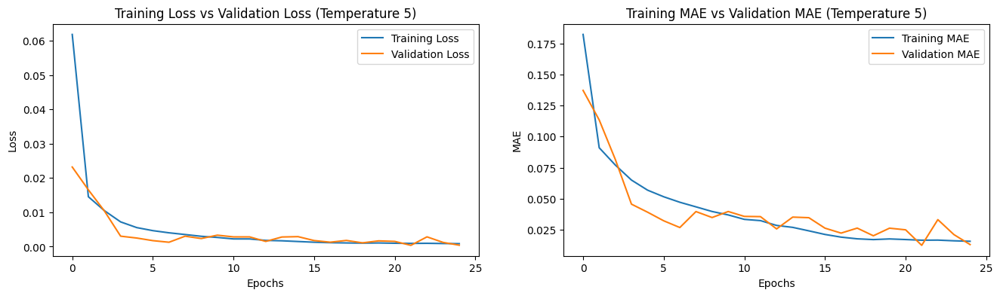


### Training with Temperature 10 ###
469/469 [==============================] - 1s 2ms/step
Epoch 1/25
188/188 [==============================] - 2s 5ms/step - loss: 0.0992 - mae: 0.2314 - val_loss: 0.0338 - val_mae: 0.1460
Epoch 2/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0201 - mae: 0.1100 - val_loss: 0.0231 - val_mae: 0.1368
Epoch 3/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0145 - mae: 0.0917 - val_loss: 0.0176 - val_mae: 0.1127
Epoch 4/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0104 - mae: 0.0770 - val_loss: 0.0092 - val_mae: 0.0749
Epoch 5/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0070 - mae: 0.0633 - val_loss: 0.0039 - val_mae: 0.0483
Epoch 6/25
188/188 [==============================] - 1s 3ms/step - loss: 0.0052 - mae: 0.0542 - val_loss: 0.0041 - val_mae: 0.0466
Epoch 7/25
188/188 [==============================] - 1s 4ms/step - loss: 0.0045 - mae: 0.0497 - val_loss: 0.0031 -

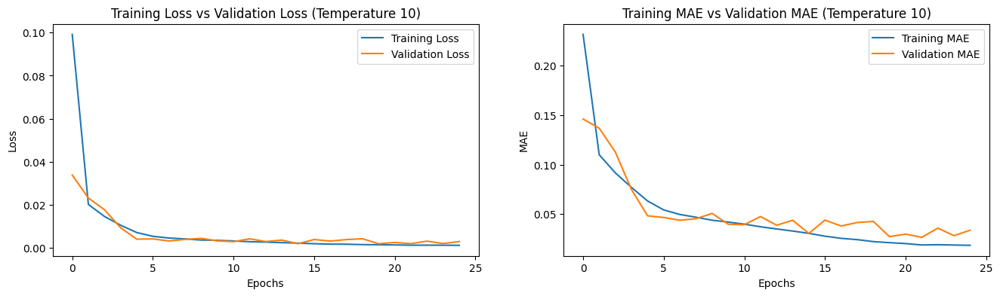

In [19]:
# Temperatures to experiment with
temperatures = [1, 5, 10]

for temperature in temperatures:
    print(f"\n### Training with Temperature {temperature} ###")

    # Get softened outputs from the teacher model
    soft_targets = get_softened_outputs(teacher_model, X_train, temperature)

    # Create the student model
    student_model_soft = create_student_model((X_train.shape[1],))

    # Train the student model using a combination of soft targets and ground truth labels
    Y_train_reshaped = Y_train.values.reshape(-1, 1)
    y_combined = 0.5 * Y_train_reshaped + 0.5 * soft_targets

    history_soft = student_model_soft.fit(X_train, y_combined, epochs=25, batch_size=64, validation_split=0.2)

    # Evaluate the student model
    val_loss_soft, val_mae_soft = student_model_soft.evaluate(X_test, Y_test)
    print(f"Validation MAE (Soft Distillation, Temperature {temperature}): {val_mae_soft}")

    # Plot the training loss vs validation loss
    plt.figure(figsize=(16, 4))

    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(history_soft.history['loss'], label='Training Loss')
    plt.plot(history_soft.history['val_loss'], label='Validation Loss')
    plt.title(f'Training Loss vs Validation Loss (Temperature {temperature})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot MAE
    plt.subplot(1, 2, 2)
    plt.plot(history_soft.history['mae'], label='Training MAE')
    plt.plot(history_soft.history['val_mae'], label='Validation MAE')
    plt.title(f'Training MAE vs Validation MAE (Temperature {temperature})')
    plt.xlabel('Epochs')
    plt.ylabel('MAE')
    plt.legend()

    plt.show()

**Step 5: Time and Memory Comparison**

In [20]:
# Timing and memory usage measurement function
def measure_training_time_memory(model, x_train, y_train, epochs=50):
    start_time = time.time()
    mem_usage = memory_usage((model.fit, (x_train, y_train), {'epochs': epochs, 'batch_size': 32, 'validation_split': 0.2, 'callbacks': [tf.keras.callbacks.EarlyStopping(patience=5)]}), interval=0.1)
    end_time = time.time()
    training_time = end_time - start_time
    max_memory = max(mem_usage)
    return training_time, max_memory

In [22]:
# Prepare soft targets for soft distillation
temperature = 3
soft_targets = get_softened_outputs(teacher_model, X_train, temperature)
Y_train = Y_train.values.reshape(-1, 1)

# Prepare combined targets for soft distillation
y_combined = 0.5 * Y_train + 0.5 * soft_targets

# Measure performance of the teacher model
print("Teacher Model Performance:")
teacher_time, teacher_memory = measure_training_time_memory(teacher_model, X_train, Y_train)

# Measure performance of the student model (hard distillation)
print("Student Model Performance Using Hard Distillation:")
student_hard_time, student_hard_memory = measure_training_time_memory(student_model_hard, X_train, Y_train)

# Measure performance of the student model (soft distillation)
print("Student Model Performance Using Soft Distillation:")
student_soft_time, student_soft_memory = measure_training_time_memory(student_model_soft, X_train, y_combined)



469/469 [==============================] - 3s 7ms/step
Teacher Model Performance:


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch 1/50
375/375 [==============================] - 4s 11ms/step - loss: 1.5831e-04 - mae: 0.0065 - val_loss: 0.0075 - val_mae: 0.0530
Epoch 2/50
375/375 [==============================] - 2s 5ms/step - loss: 1.7227e-04 - mae: 0.0068 - val_loss: 0.0076 - val_mae: 0.0537
Epoch 3/50
375/375 [==============================] - 2s 6ms/step - loss: 1.5860e-04 - mae: 0.0066 - val_loss: 0.0062 - val_mae: 0.0479
Epoch 4/50
375/375 [==============================] - 4s 11ms/step - loss: 1.3919e-04 - mae: 0.0062 - val_loss: 0.0094 - val_mae: 0.0599
Epoch 5/50
375/375 [==============================] - 2s 5ms/step - loss: 1.4438e-04 - mae: 0.0063 - val_loss: 0.0067 - val_mae: 0.0512
Epoch 6/50
375/375 [==============================] - 2s 5ms/step - loss: 1.1287e-04 - mae: 0.0057 - val_loss: 0.0068 - val_mae: 0.0506
Epoch 7/50
375/375 [==============================] - 2s 5ms/step - loss: 1.2620e-04 - mae: 0.0060 - val_loss: 0.0070 - val_mae: 0.0513
Epoch 8/50
375/375 [==========================

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch 1/50
375/375 [==============================] - 1s 3ms/step - loss: 0.0019 - mae: 0.0254 - val_loss: 0.0017 - val_mae: 0.0242
Epoch 2/50
375/375 [==============================] - 2s 5ms/step - loss: 0.0019 - mae: 0.0252 - val_loss: 0.0023 - val_mae: 0.0281
Epoch 3/50
375/375 [==============================] - 3s 8ms/step - loss: 0.0018 - mae: 0.0249 - val_loss: 0.0026 - val_mae: 0.0291
Epoch 4/50
375/375 [==============================] - 4s 10ms/step - loss: 0.0018 - mae: 0.0245 - val_loss: 0.0020 - val_mae: 0.0239
Epoch 5/50
375/375 [==============================] - 3s 7ms/step - loss: 0.0016 - mae: 0.0243 - val_loss: 0.0020 - val_mae: 0.0249
Epoch 6/50
375/375 [==============================] - 1s 4ms/step - loss: 0.0017 - mae: 0.0244 - val_loss: 0.0069 - val_mae: 0.0522


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Student Model Performance Using Soft Distillation:


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch 1/50
375/375 [==============================] - 1s 3ms/step - loss: 0.0011 - mae: 0.0184 - val_loss: 0.0025 - val_mae: 0.0291
Epoch 2/50
375/375 [==============================] - 1s 3ms/step - loss: 9.7780e-04 - mae: 0.0175 - val_loss: 0.0016 - val_mae: 0.0238
Epoch 3/50
375/375 [==============================] - 1s 3ms/step - loss: 9.8814e-04 - mae: 0.0173 - val_loss: 8.0993e-04 - val_mae: 0.0180
Epoch 4/50
375/375 [==============================] - 2s 5ms/step - loss: 9.1710e-04 - mae: 0.0167 - val_loss: 7.1169e-04 - val_mae: 0.0156
Epoch 5/50
375/375 [==============================] - 1s 3ms/step - loss: 8.6524e-04 - mae: 0.0158 - val_loss: 6.6425e-04 - val_mae: 0.0162
Epoch 6/50
375/375 [==============================] - 1s 3ms/step - loss: 8.3628e-04 - mae: 0.0155 - val_loss: 6.7608e-04 - val_mae: 0.0153
Epoch 7/50
375/375 [==============================] - 2s 5ms/step - loss: 8.2921e-04 - mae: 0.0155 - val_loss: 7.1112e-04 - val_mae: 0.0149
Epoch 8/50
375/375 [============

In [23]:
print(f"Teacher Model - Training Time: {teacher_time} seconds, Memory Usage: {teacher_memory} MiB")
print(f"Student Model (Hard Distillation) - Training Time: {student_hard_time} seconds, Memory Usage: {student_hard_memory} MiB")
print(f"Student Model (Soft Distillation) - Training Time: {student_soft_time} seconds, Memory Usage: {student_soft_memory} MiB")

Teacher Model - Training Time: 20.792418241500854 seconds, Memory Usage: 2163.77734375 MiB
Student Model (Hard Distillation) - Training Time: 14.168599128723145 seconds, Memory Usage: 2184.83203125 MiB
Student Model (Soft Distillation) - Training Time: 42.8801646232605 seconds, Memory Usage: 2227.03125 MiB


### **USA Dataset**

**Step 1: Loading Data**

In [24]:
# Load USA dataset
usa_data = pd.read_excel('/content/DataSet_USA_3k_5k.xlsx')

**Step 2: Data Preparation**

In [25]:
# Columns to drop
columns_to_drop_usa = (
    [f'frequency_{i}' for i in range(1, 77)] +
    [f'GSNR_{i}' for i in range(2, 77)] +
    ['Source', 'Destination', 'Number of ON channels'] +
    [f'SNR_NL_{i}' for i in range(1, 77)] +
    [f'OSNR_{i}' for i in range(1, 77)]
)
usa_data = usa_data.drop(columns=columns_to_drop_usa)

In [26]:
print(usa_data.head())
print(usa_data.info())
print(usa_data.describe())

    Power_1   Power_2   Power_3   Power_4   Power_5   Power_6   Power_7  \
0  0.000000  0.000000  0.000096  0.000096  0.000096  0.000000  0.000096   
1  0.000000  0.000096  0.000000  0.000096  0.000000  0.000096  0.000000   
2  0.000000  0.000000  0.000000  0.000096  0.000000  0.000000  0.000000   
3  0.000096  0.000096  0.000095  0.000095  0.000096  0.000000  0.000000   
4  0.000000  0.000000  0.000096  0.000000  0.000096  0.000000  0.000000   

   Power_8   Power_9  Power_10  ...    ASE_70    ASE_71    ASE_72    ASE_73  \
0      0.0  0.000096       0.0  ...  0.000100  0.000100  0.000100  0.000100   
1      0.0  0.000000       0.0  ...  0.000003  0.000100  0.000100  0.000003   
2      0.0  0.000096       0.0  ...  0.000100  0.000003  0.000100  0.000100   
3      0.0  0.000096       0.0  ...  0.000002  0.000003  0.000003  0.000100   
4      0.0  0.000096       0.0  ...  0.000100  0.000002  0.000003  0.000003   

     ASE_74    ASE_75    ASE_76     GSNR_1  No. Spans  Total Distance(m)  

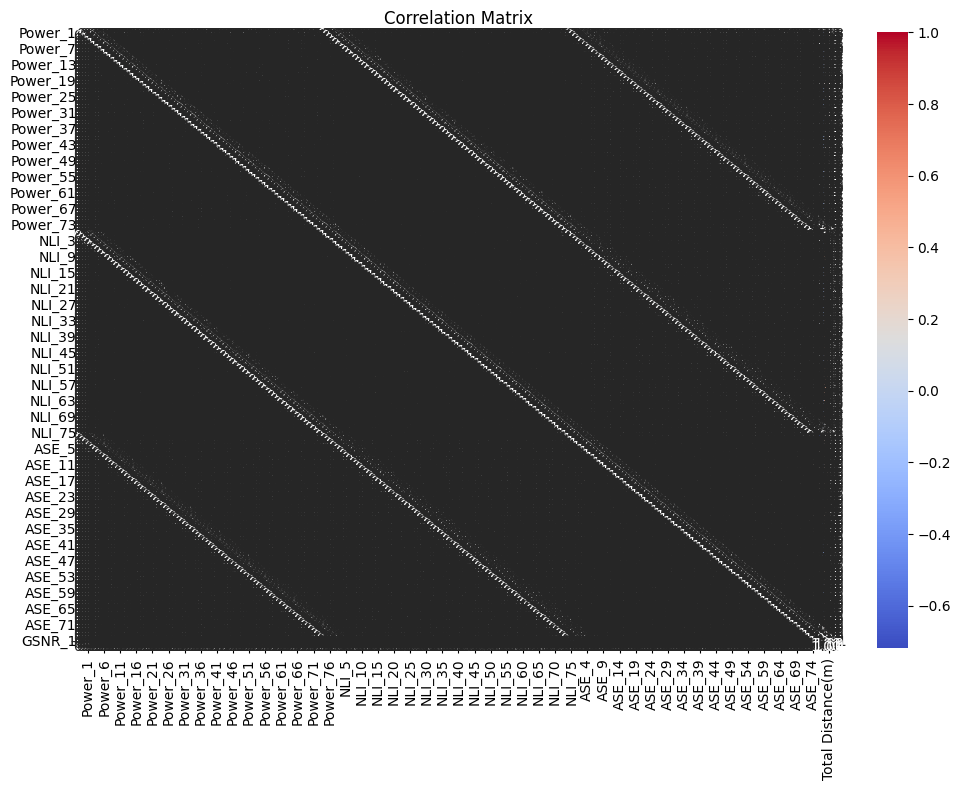

In [27]:
# Select relevant columns
features = usa_data.columns.difference(['GSNR_1'])
target = 'GSNR_1'

# Combine the datasets for visualization
usa_data['Dataset'] = 'USA'
combined_data = pd.concat([usa_data])

# Correlation matrix (excluding 'Dataset' column)
plt.figure(figsize=(12, 8))
correlation_matrix = combined_data.drop(columns=['Dataset']).corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [28]:
# Number of columns for the subplots
num_cols = 5

# Individual feature distributions
num_features = len(features)
num_rows = (num_features + num_cols - 1) // num_cols  # Calculate the number of rows needed

plt.figure(figsize=(num_cols * 6, num_rows * 4))

for i, feature in enumerate(features):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.histplot(combined_data[feature], kde=True, bins=30)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

# Relationship with target variable
plt.figure(figsize=(num_cols * 6, num_rows * 4))

for i, feature in enumerate(features):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.scatterplot(x=combined_data[feature], y=combined_data[target], hue=combined_data['Dataset'])
    plt.title(f'Relationship between {feature} and {target}')
    plt.xlabel(feature)
    plt.ylabel(target)

plt.tight_layout()
plt.show()

In [29]:
# Separate features and target
X_usa = usa_data[features]
y_usa = usa_data[[target]]  # Ensure y is a DataFrame for consistent scaling

In [30]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Initialize the scaler
scaler = MinMaxScaler()

# Fit and transform the features and target
X_usa_scaled = scaler.fit_transform(X_usa)
y_usa_scaled = scaler.fit_transform(y_usa)

# Flatten the target variables
y_usa_flat = y_usa_scaled.flatten()

# Convert the scaled features back to DataFrames for easier handling
X_usa_scaled = pd.DataFrame(X_usa_scaled, columns=features)

# Convert the flattened target variables back to Series for consistency
y_usa_flat = pd.Series(y_usa_flat, name=target)

**Step 3: Model Training on USA Dataset**

In [31]:
# Assuming 'x' and 'y' are your DataFrames for MinMax normalized data
# Perform the custom train-test split on the normalized data
X_train, X_test, Y_train, Y_test = custom_train_test_split(X_usa_scaled, y_usa_flat)

# Display shapes to verify the split
print("Normalized data with equal path distribution in train and test data :\n")
print("Train data shape:", X_train.shape)
print("Test data shape:", X_test.shape)
print("Train labels shape:", Y_train.shape)
print("Test labels shape:", Y_test.shape)

Normalized data with equal path distribution in train and test data :

Train data shape: (30000, 230)
Test data shape: (6000, 230)
Train labels shape: (30000,)
Test labels shape: (6000,)


In [32]:
# Define a large teacher model architecture
teacher_model = Sequential([
    Dense(256, activation='relu', input_shape=(len(features),)),  # First layer with 256 neurons
    Dropout(0.2),  # Add dropout for regularization
    Dense(128, activation='relu'),  # Second layer with 128 neurons
    Dropout(0.2),
    Dense(64, activation='relu'),  # Third layer with 64 neurons
    Dropout(0.2),
    Dense(32, activation='relu'),  # Fourth layer with 32 neurons
    Dense(16, activation='relu'),  # Fifth layer with 16 neurons
    Dense(1)  # Output layer for regression task
])

# Compile the model
teacher_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the teacher model
history = teacher_model.fit(X_train, Y_train, epochs=25, batch_size=64, validation_split=0.2)  # Increase epochs for better training

# Evaluate the teacher model
val_loss, val_mae = teacher_model.evaluate(X_test, Y_test)
print(f"Validation MAE: {val_mae}")


Epoch 1/25
375/375 [==============================] - 4s 7ms/step - loss: 0.0285 - mae: 0.0701 - val_loss: 5.3895e-05 - val_mae: 0.0062
Epoch 2/25
375/375 [==============================] - 2s 6ms/step - loss: 0.0229 - mae: 0.0563 - val_loss: 4.6674e-05 - val_mae: 0.0060
Epoch 3/25
375/375 [==============================] - 2s 6ms/step - loss: 0.0120 - mae: 0.0353 - val_loss: 2.6251e-05 - val_mae: 0.0045
Epoch 4/25
375/375 [==============================] - 4s 10ms/step - loss: 9.5811e-04 - mae: 0.0116 - val_loss: 1.9147e-05 - val_mae: 0.0035
Epoch 5/25
375/375 [==============================] - 3s 7ms/step - loss: 5.5434e-04 - mae: 0.0102 - val_loss: 1.5163e-05 - val_mae: 0.0026
Epoch 6/25
375/375 [==============================] - 2s 7ms/step - loss: 3.9977e-04 - mae: 0.0093 - val_loss: 1.6023e-05 - val_mae: 0.0027
Epoch 7/25
375/375 [==============================] - 2s 5ms/step - loss: 3.0084e-04 - mae: 0.0087 - val_loss: 2.1778e-05 - val_mae: 0.0038
Epoch 8/25
375/375 [===========

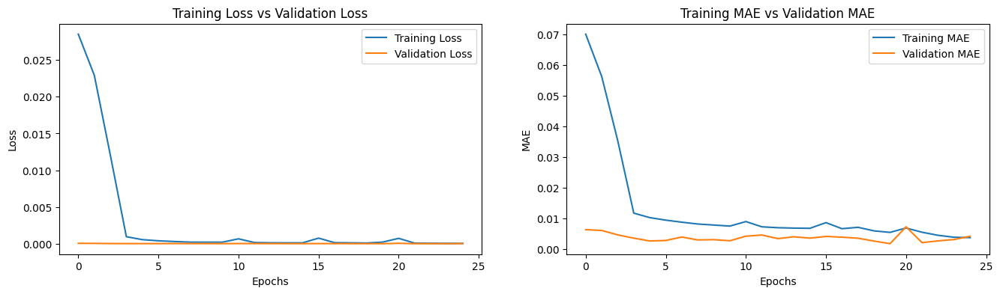

In [33]:
# Plot the training loss vs validation loss
plt.figure(figsize=(16, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training Loss vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot MAE
plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.title('Training MAE vs Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()


**Step 4 : Training Student Model**

**Hard Distillation**

In [34]:
# Define the student model architecture
student_model_hard = Sequential([
    Dense(64, activation='relu', input_shape=(len(features),)),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dropout(0.2),
    Dense(1)
])

# Compile the student model
student_model_hard.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the student model
history_hard = student_model_hard.fit(X_train, Y_train, epochs=25, batch_size=64, validation_split=0.2)  # Increase epochs for better training

# Evaluate the student model
val_loss_hard, val_mae_hard = student_model_hard.evaluate(X_test, Y_test)
print(f"Validation MAE (Hard Distillation): {val_mae_hard}")


Epoch 1/25
375/375 [==============================] - 2s 4ms/step - loss: 0.0331 - mae: 0.0868 - val_loss: 8.6014e-05 - val_mae: 0.0080
Epoch 2/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0241 - mae: 0.0593 - val_loss: 4.9432e-05 - val_mae: 0.0060
Epoch 3/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0236 - mae: 0.0570 - val_loss: 4.6159e-05 - val_mae: 0.0058
Epoch 4/25
375/375 [==============================] - 1s 4ms/step - loss: 0.0234 - mae: 0.0563 - val_loss: 4.0514e-05 - val_mae: 0.0054
Epoch 5/25
375/375 [==============================] - 2s 5ms/step - loss: 0.0229 - mae: 0.0553 - val_loss: 4.3027e-05 - val_mae: 0.0058
Epoch 6/25
375/375 [==============================] - 2s 6ms/step - loss: 0.0219 - mae: 0.0539 - val_loss: 2.9888e-05 - val_mae: 0.0049
Epoch 7/25
375/375 [==============================] - 1s 4ms/step - loss: 0.0197 - mae: 0.0509 - val_loss: 3.0110e-05 - val_mae: 0.0049
Epoch 8/25
375/375 [============================

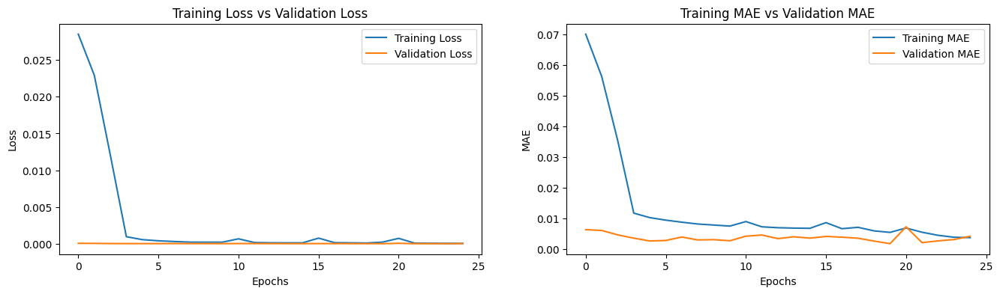

In [35]:
# Plot the training loss vs validation loss
plt.figure(figsize=(16, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training Loss vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot MAE
plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Training MAE')
plt.plot(history.history['val_mae'], label='Validation MAE')
plt.title('Training MAE vs Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()


**Soft Distillation**

In [36]:
def get_softened_outputs(model, data, temperature=1):
    logits = model.predict(data) / temperature
    exp_logits = np.exp(logits)
    return exp_logits / np.sum(exp_logits, axis=1, keepdims=True)

In [37]:
# Define the student model architecture
def create_student_model(input_shape):
    model = Sequential([
        Dense(64, activation='relu', input_shape=input_shape),
        Dropout(0.2),
        Dense(32, activation='relu'),
        Dropout(0.2),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse', metrics=['mae'])
    return model


### Training with Temperature 1 ###
938/938 [==============================] - 2s 2ms/step
Epoch 1/25
375/375 [==============================] - 2s 4ms/step - loss: 0.0303 - mae: 0.1192 - val_loss: 0.0017 - val_mae: 0.0364
Epoch 2/25
375/375 [==============================] - 2s 4ms/step - loss: 0.0092 - mae: 0.0639 - val_loss: 6.3922e-04 - val_mae: 0.0230
Epoch 3/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0076 - mae: 0.0524 - val_loss: 2.4688e-04 - val_mae: 0.0139
Epoch 4/25
375/375 [==============================] - 2s 5ms/step - loss: 0.0069 - mae: 0.0455 - val_loss: 2.3697e-05 - val_mae: 0.0036
Epoch 5/25
375/375 [==============================] - 2s 6ms/step - loss: 0.0065 - mae: 0.0412 - val_loss: 6.9844e-05 - val_mae: 0.0079
Epoch 6/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0062 - mae: 0.0378 - val_loss: 1.3302e-05 - val_mae: 0.0031
Epoch 7/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0061 - mae: 0.0355 -

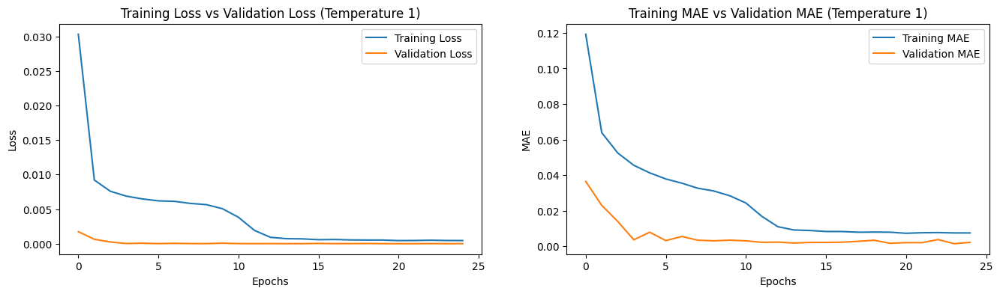


### Training with Temperature 5 ###
938/938 [==============================] - 2s 2ms/step
Epoch 1/25
375/375 [==============================] - 3s 6ms/step - loss: 0.0322 - mae: 0.1192 - val_loss: 0.0011 - val_mae: 0.0288
Epoch 2/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0086 - mae: 0.0600 - val_loss: 1.5303e-04 - val_mae: 0.0099
Epoch 3/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0074 - mae: 0.0502 - val_loss: 3.5668e-05 - val_mae: 0.0034
Epoch 4/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0069 - mae: 0.0461 - val_loss: 2.6709e-05 - val_mae: 0.0043
Epoch 5/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0067 - mae: 0.0426 - val_loss: 4.8312e-05 - val_mae: 0.0064
Epoch 6/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0062 - mae: 0.0391 - val_loss: 5.7252e-05 - val_mae: 0.0070
Epoch 7/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0061 - mae: 0.0360 -

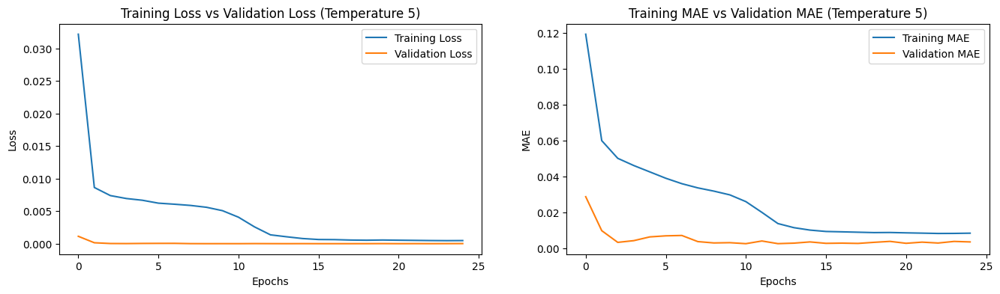


### Training with Temperature 10 ###
938/938 [==============================] - 2s 2ms/step
Epoch 1/25
375/375 [==============================] - 3s 5ms/step - loss: 0.0616 - mae: 0.1669 - val_loss: 0.0050 - val_mae: 0.0623
Epoch 2/25
375/375 [==============================] - 2s 4ms/step - loss: 0.0124 - mae: 0.0818 - val_loss: 0.0019 - val_mae: 0.0394
Epoch 3/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0092 - mae: 0.0651 - val_loss: 6.8592e-04 - val_mae: 0.0233
Epoch 4/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0079 - mae: 0.0552 - val_loss: 2.2704e-04 - val_mae: 0.0131
Epoch 5/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0071 - mae: 0.0486 - val_loss: 1.8445e-04 - val_mae: 0.0123
Epoch 6/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0067 - mae: 0.0434 - val_loss: 6.7268e-05 - val_mae: 0.0067
Epoch 7/25
375/375 [==============================] - 1s 3ms/step - loss: 0.0063 - mae: 0.0386 - va

In [ ]:
# Temperatures to experiment with
temperatures = [1, 5, 10]

for temperature in temperatures:
    print(f"\n### Training with Temperature {temperature} ###")

    # Get softened outputs from the teacher model
    soft_targets = get_softened_outputs(teacher_model, X_train, temperature)

    # Create the student model
    student_model_soft = create_student_model((X_train.shape[1],))

    # Train the student model using a combination of soft targets and ground truth labels
    Y_train_reshaped = Y_train.values.reshape(-1, 1)
    y_combined = 0.5 * Y_train_reshaped + 0.5 * soft_targets

    history_soft = student_model_soft.fit(X_train, y_combined, epochs=25, batch_size=64, validation_split=0.2)

    # Evaluate the student model
    val_loss_soft, val_mae_soft = student_model_soft.evaluate(X_test, Y_test)
    print(f"Validation MAE (Soft Distillation, Temperature {temperature}): {val_mae_soft}")

    # Plot the training loss vs validation loss
    plt.figure(figsize=(16, 4))

    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(history_soft.history['loss'], label='Training Loss')
    plt.plot(history_soft.history['val_loss'], label='Validation Loss')
    plt.title(f'Training Loss vs Validation Loss (Temperature {temperature})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot MAE
    plt.subplot(1, 2, 2)
    plt.plot(history_soft.history['mae'], label='Training MAE')
    plt.plot(history_soft.history['val_mae'], label='Validation MAE')
    plt.title(f'Training MAE vs Validation MAE (Temperature {temperature})')
    plt.xlabel('Epochs')
    plt.ylabel('MAE')
    plt.legend()

    plt.show()

**Step 5 : Time and Memory Comparison**

In [ ]:
# Prepare soft targets for soft distillation
temperature = 3
soft_targets = get_softened_outputs(teacher_model, X_train, temperature)

# Prepare combined targets for soft distillation
y_combined = 0.5 * Y_train + 0.5 * soft_targets

# Measure performance of the teacher model
print("Teacher Model Performance:")
teacher_time, teacher_memory = measure_training_time_memory(teacher_model, X_train, Y_train)

# Measure performance of the student model (hard distillation)
print("Student Model Performance Using Hard Distillation:")
student_hard_time, student_hard_memory = measure_training_time_memory(student_model_hard, X_train, Y_train)

# Measure performance of the student model (soft distillation)
print("Student Model Performance Using Soft Distillation:")
student_soft_time, student_soft_memory = measure_training_time_memory(student_model_soft, X_train, y_combined)



In [42]:
print(f"Teacher Model - Training Time: {teacher_time} seconds, Memory Usage: {teacher_memory} MiB")
print(f"Student Model (Hard Distillation) - Training Time: {student_hard_time} seconds, Memory Usage: {student_hard_memory} MiB")
print(f"Student Model (Soft Distillation) - Training Time: {student_soft_time} seconds, Memory Usage: {student_soft_memory} MiB")

Teacher Model - Training Time: 20.792418241500854 seconds, Memory Usage: 2163.77734375 MiB
Student Model (Hard Distillation) - Training Time: 14.168599128723145 seconds, Memory Usage: 2184.83203125 MiB
Student Model (Soft Distillation) - Training Time: 42.8801646232605 seconds, Memory Usage: 2227.03125 MiB


# ***Conclusion***

The teacher model, being a larger and more complex architecture, takes longer for inference, especially with larger datasets. In contrast, both hard and soft distillation methods for the student model show relatively similar inference times. However, soft distillation requires additional time to calculate soft labels, making its overall process slightly longer. In terms of accuracy, the teacher model performs best as expected, followed by the hard distillation method which uses actual labels. Soft distillation, while least accurate, benefits from a smoothing parameter, where a temperature (T) value of 1 makes the function equivalent to softmax, and higher values of T smooth the label distribution but reduce accuracy. Training a student model with hard distillation is akin to training the teacher model if the architectures match, with the primary difference being the use of teacher model predictions to guide the student model.